# Detectando objetos com YOLO e OpenCV - Explorando mais opções

## Etapa 1 - Importando as bibliotecas

In [ ]:
import cv2
print(cv2.__version__)

4.11.0


In [ ]:
!pip install opencv-python==4.4.0.40

     |████████████████████████████████| 49.4MB 81kB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: opencv-python 4.1.2.30
    Uninstalling opencv-python-4.1.2.30:
      Successfully uninstalled opencv-python-4.1.2.30


In [ ]:
import cv2
import numpy as np
import time
import os
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import zipfile
print(cv2.__version__)

4.11.0


## Etapa 2 - Conectando com o Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


## Etapa 3 - Carregando os arquivos do modelo treinado

In [ ]:
path ='/content/gdrive/MyDrive/YOLO/modelo_YOLOv4.zip'
zip_object = zipfile.ZipFile(file=path, mode="r")
zip_object.extractall("./")
zip_object.close()

In [ ]:
labelsPath = os.path.sep.join(['/content/cfg', "coco.names"])
LABELS = open(labelsPath).read().strip().split("\n")

In [ ]:
weightsPath = os.path.sep.join(['/content/', "yolov4.weights"])
configPath = os.path.sep.join(['/content/cfg', "yolov4.cfg"])

In [ ]:
net = cv2.dnn.readNet(configPath, weightsPath)

## Etapa 4 - Definindo mais configurações para a detecção

In [ ]:
np.random.seed(42)
COLORS = np.random.randint(0, 255, size=(len(LABELS), 3), dtype="uint8")

In [ ]:
ln = net.getLayerNames()
print("Todas as camadas (layers):")
print(ln)
print("Total: "+ str(len(ln)))
print("Camadas de saída: ")
print(net.getUnconnectedOutLayers())
ln = [ln[i - 1] for i in net.getUnconnectedOutLayers()]
print(ln)

Todas as camadas (layers):
('conv_0', 'bn_0', 'mish_1', 'conv_1', 'bn_1', 'mish_2', 'conv_2', 'bn_2', 'mish_3', 'identity_3', 'conv_4', 'bn_4', 'mish_5', 'conv_5', 'bn_5', 'mish_6', 'conv_6', 'bn_6', 'mish_7', 'shortcut_7', 'conv_8', 'bn_8', 'mish_9', 'concat_9', 'conv_10', 'bn_10', 'mish_11', 'conv_11', 'bn_11', 'mish_12', 'conv_12', 'bn_12', 'mish_13', 'identity_13', 'conv_14', 'bn_14', 'mish_15', 'conv_15', 'bn_15', 'mish_16', 'conv_16', 'bn_16', 'mish_17', 'shortcut_17', 'conv_18', 'bn_18', 'mish_19', 'conv_19', 'bn_19', 'mish_20', 'shortcut_20', 'conv_21', 'bn_21', 'mish_22', 'concat_22', 'conv_23', 'bn_23', 'mish_24', 'conv_24', 'bn_24', 'mish_25', 'conv_25', 'bn_25', 'mish_26', 'identity_26', 'conv_27', 'bn_27', 'mish_28', 'conv_28', 'bn_28', 'mish_29', 'conv_29', 'bn_29', 'mish_30', 'shortcut_30', 'conv_31', 'bn_31', 'mish_32', 'conv_32', 'bn_32', 'mish_33', 'shortcut_33', 'conv_34', 'bn_34', 'mish_35', 'conv_35', 'bn_35', 'mish_36', 'shortcut_36', 'conv_37', 'bn_37', 'mish_38'

## Etapa 5 - Carregando a imagem onde será feita a detecção

In [ ]:
def mostrar(img):
  fig = plt.gcf()
  fig.set_size_inches(16, 10)
  plt.axis("off")
  plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
  plt.show()

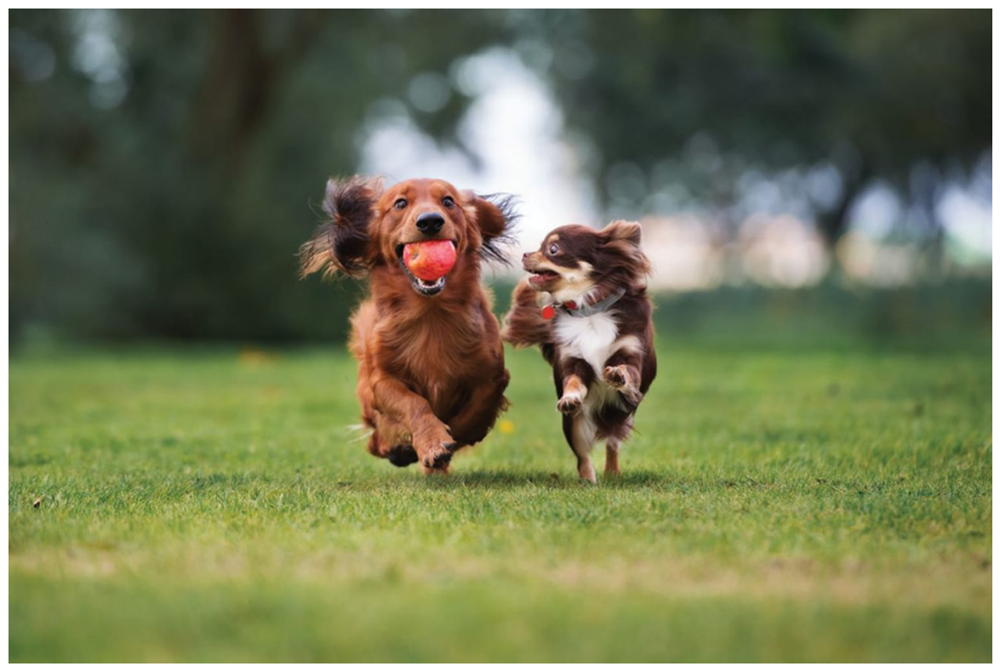

Altura: 1000
Largura: 1500


In [ ]:
imagem = cv2.imread("/content/gdrive/MyDrive/YOLO/imagens/cachorros02.jpg")
mostrar(imagem)
imagem_cp = imagem.copy()
(H, W) = imagem.shape[:2]
print("Altura: " + str(H) + "\nLargura: " + str(W))

## Etapa 6 - Processando a imagem de entrada

### Redimensionamento da imagem (opcional)

In [ ]:
imagem.shape

(1000, 1500, 3)

In [ ]:
proporcao = imagem.shape[1] / imagem.shape[0]
proporcao

1.5

In [ ]:
1500 / 1.5

1000.0

In [ ]:
def redimensionar(imagem, largura_maxima = 600):
  if imagem.shape[1] > largura_maxima:
    # Redimensionamento sem perder a proporção
    proporcao = imagem.shape[1] / imagem.shape[0]
    imagem_largura = largura_maxima
    imagem_altura = int(imagem_largura / proporcao)
  else:
    imagem_largura = imagem.shape[1]
    imagem_altura = imagem.shape[0]

  imagem = cv2.resize(imagem, (imagem_largura, imagem_altura))
  return imagem

In [ ]:
imagem = redimensionar(imagem)

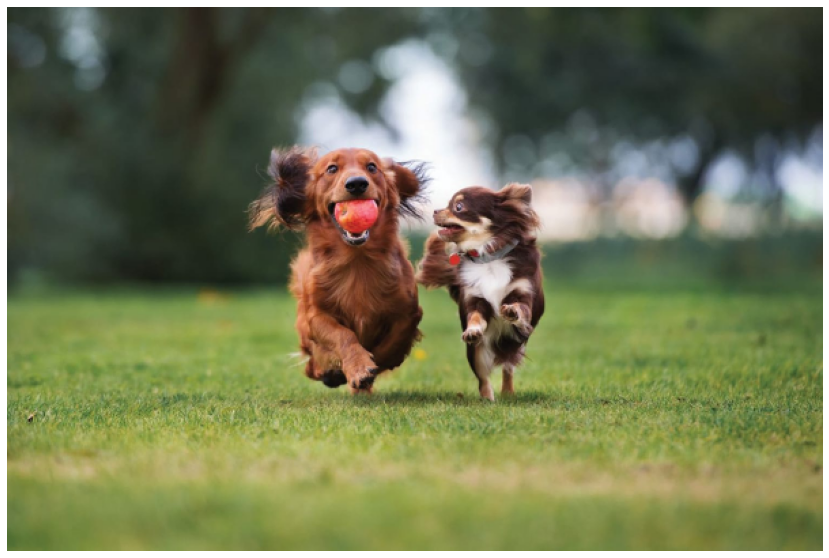

Altura: 400
Largura: 600


In [ ]:
mostrar(imagem)
(H, W) = imagem.shape[:2]
imagem_cp = imagem.copy()
print('Altura: ' + str(H) + '\nLargura: ' + str(W))

### Construindo o blob da imagem

In [ ]:
def blob_imagem(net, imagem, mostrar_texto=True):
  inicio = time.time()

  blob = cv2.dnn.blobFromImage(imagem, 1 / 255.0, (416, 416), swapRB=True, crop=False)
  net.setInput(blob)
  layerOutputs = net.forward(ln)

  termino = time.time()

  if mostrar_texto:
    print("YOLO levou {:.2f} segundos".format(termino - inicio))

  return net, imagem, layerOutputs

In [ ]:
net, imagem, layerOutputs = blob_imagem(net, imagem)

YOLO levou 7.40 segundos


## Etapa 7 - Definindo as variáveis

In [ ]:
_threshold = 0.5
_threshold_NMS = 0.3
caixas = []
confiancas = []
IDclasses = []

## Etapa 8 - Realizando a predição

In [ ]:
def deteccoes(detection, _threshold, caixas, confiancas, IDclasses):
  scores = detection[5:]
  classeID = np.argmax(scores)
  confianca = scores[classeID]

  if confianca > _threshold:
      caixa = detection[0:4] * np.array([W, H, W, H])
      (centerX, centerY, width, height) = caixa.astype("int")
      x = int(centerX - (width / 2))
      y = int(centerY - (height / 2))

      caixas.append([x, y, int(width), int(height)])
      confiancas.append(float(confianca))
      IDclasses.append(classeID)

  return caixas, confiancas, IDclasses

In [ ]:
for output in layerOutputs:
    for detection in output:
        caixas, confiancas, IDclasses = deteccoes(detection, _threshold, caixas, confiancas, IDclasses)

In [ ]:
print(caixas)
print(confiancas)
print(IDclasses)

[[435, 257, 347, 458], [436, 258, 345, 455], [740, 323, 246, 408], [733, 322, 255, 409], [734, 322, 252, 410], [760, 321, 227, 412], [758, 321, 232, 412], [759, 321, 230, 411], [757, 342, 234, 395], [435, 260, 348, 449], [436, 257, 347, 453], [751, 325, 241, 396], [748, 321, 245, 404]]
[0.9754098057746887, 0.98139488697052, 0.5843073725700378, 0.7508536577224731, 0.7460799813270569, 0.9840341806411743, 0.9888638257980347, 0.9884310960769653, 0.5092483162879944, 0.9928240776062012, 0.99269700050354, 0.9902257323265076, 0.9841699600219727]
[np.int64(16), np.int64(16), np.int64(16), np.int64(16), np.int64(16), np.int64(16), np.int64(16), np.int64(16), np.int64(16), np.int64(16), np.int64(16), np.int64(16), np.int64(16)]


In [ ]:
len(caixas)

13

## Etapa 9 - Aplicando a Non-Maxima Suppression

In [ ]:
objs = cv2.dnn.NMSBoxes(caixas, confiancas, _threshold, _threshold_NMS)

In [ ]:
print("Objetos detectados: " + str(len(objs)))

Objetos detectados: 2


## Etapa 10 - Mostrando o resultado da detecção na imagem

In [ ]:
def check_negativo(n):
  if (n < 0):
    return 0
  else:
    return n

def funcoes_imagem(imagem, i, confiancas, caixas, COLORS, LABELS, mostrar_texto=True):
  (x, y) = (caixas[i][0], caixas[i][1])
  (w, h) = (caixas[i][2], caixas[i][3])
  cor = [int(c) for c in COLORS[IDclasses[i]]]
  cv2.rectangle(imagem, (x, y), (x + w, y + h), cor, 2)
  texto = "{}: {:.4f}".format(LABELS[IDclasses[i]], confiancas[i])
  if mostrar_texto:
    print("> " + texto)
    print(x,y,w,h)
  cv2.putText(imagem, texto, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, cor, 2)

  return imagem,x,y,w,h

> dog: 0.9928
435 260 348 449


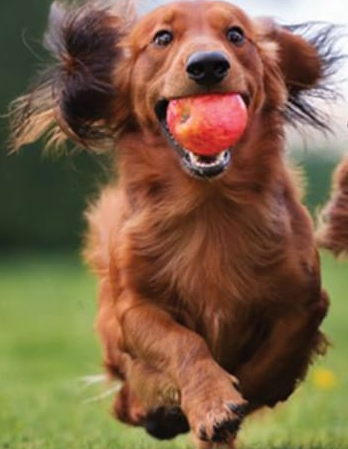

> dog: 0.9902
751 325 241 396


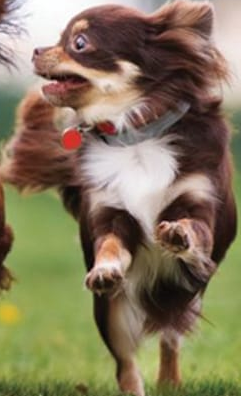

In [ ]:
if len(objs) > 0:
  for i in objs.flatten():
    imagem, x, y, w, h = funcoes_imagem(imagem, i, confiancas, caixas, COLORS, LABELS)
    objeto = imagem_cp[y:y + h, x:x + w]
    cv2_imshow(objeto)

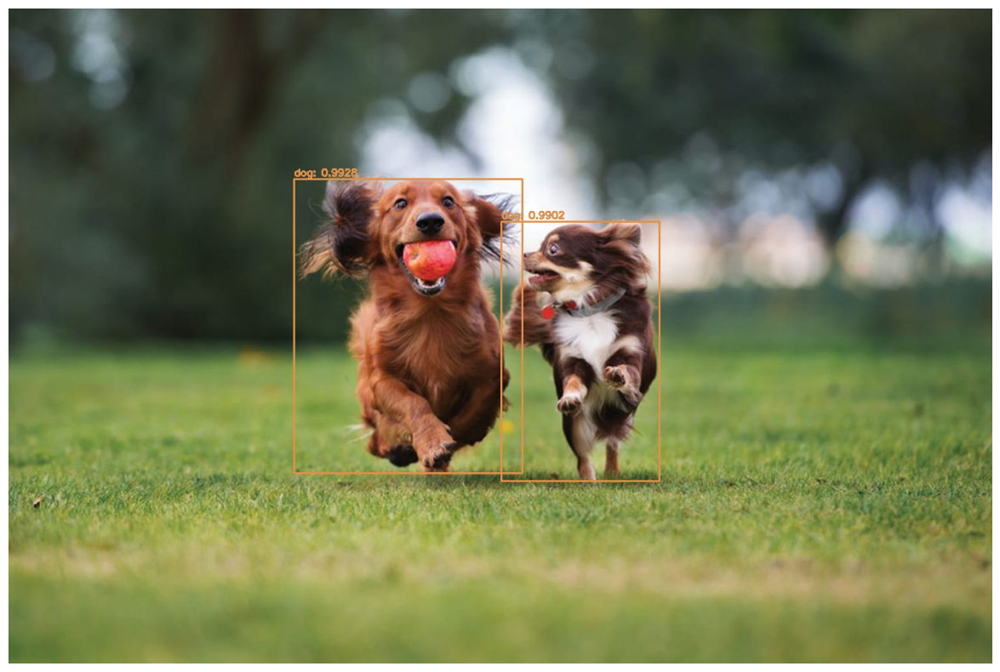

In [ ]:
mostrar(imagem)

# Fazendo a detecção em múltiplas imagens de uma vez

In [ ]:
path = '/content/gdrive/MyDrive/YOLO/imagens/fotos_teste.zip'
zip_object = zipfile.ZipFile(file = path, mode = 'r')
zip_object.extractall('./')
zip_object.close()

In [ ]:
diretorio_fotos = 'fotos_teste'
caminhos = [os.path.join(diretorio_fotos, f) for f in os.listdir(diretorio_fotos)]
print(caminhos)

['fotos_teste/img-canecas.jpg', 'fotos_teste/gato03.jpg', 'fotos_teste/person.jpg', 'fotos_teste/dog.jpg', 'fotos_teste/cachorros.jpg', 'fotos_teste/gato02.jpg', 'fotos_teste/gato04.jpg', 'fotos_teste/cachorros02.jpg']


YOLO levou 1.99 segundos


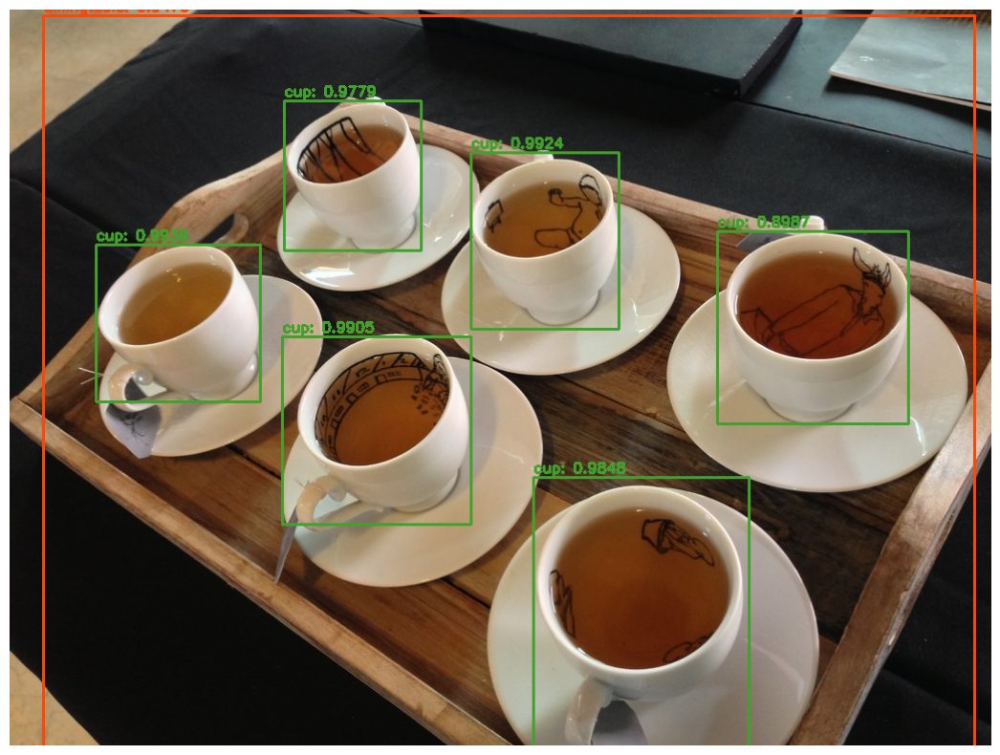

YOLO levou 1.86 segundos


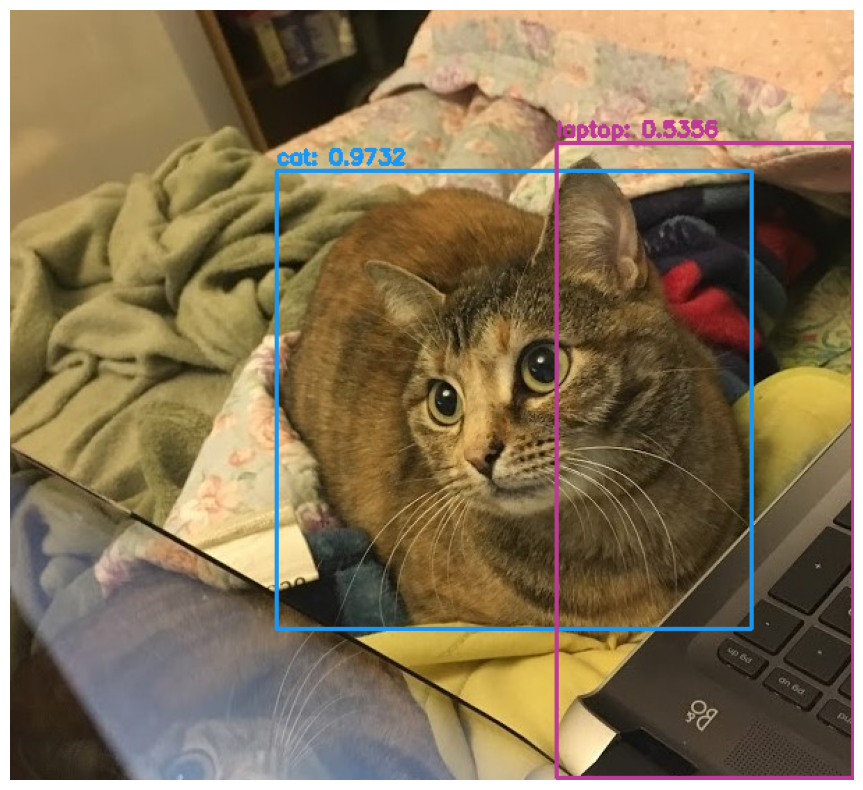

YOLO levou 1.26 segundos


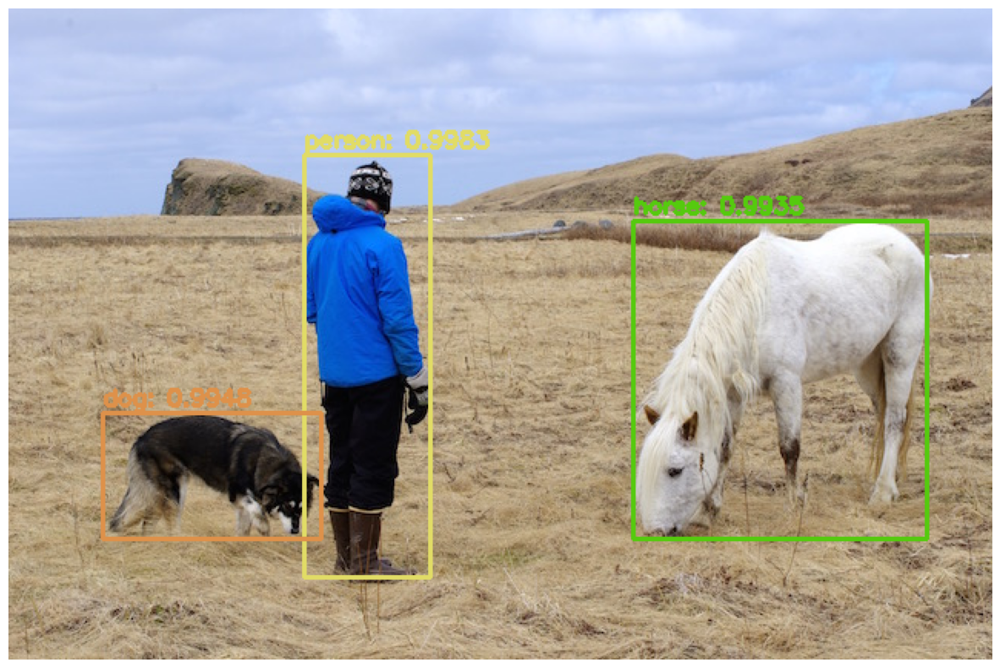

YOLO levou 1.28 segundos


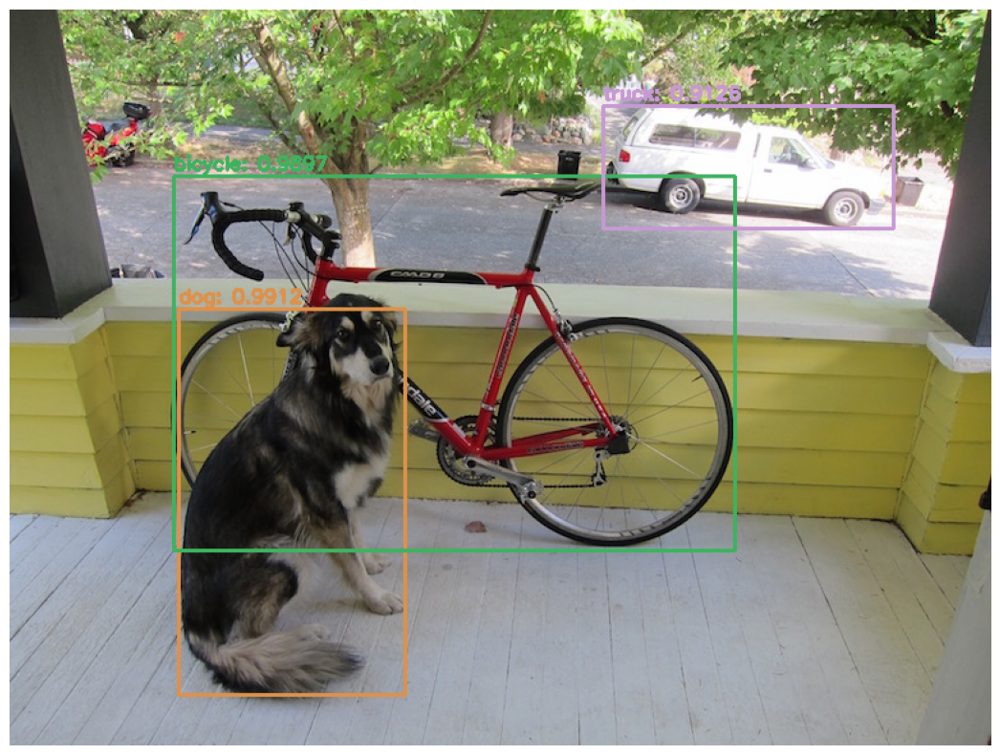

YOLO levou 1.31 segundos


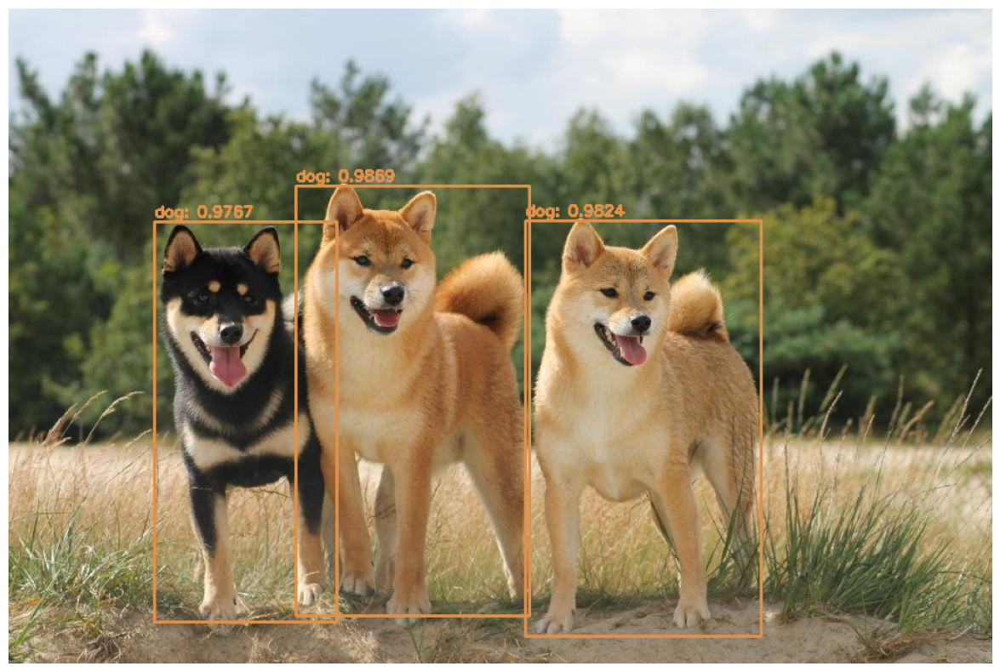

YOLO levou 1.33 segundos


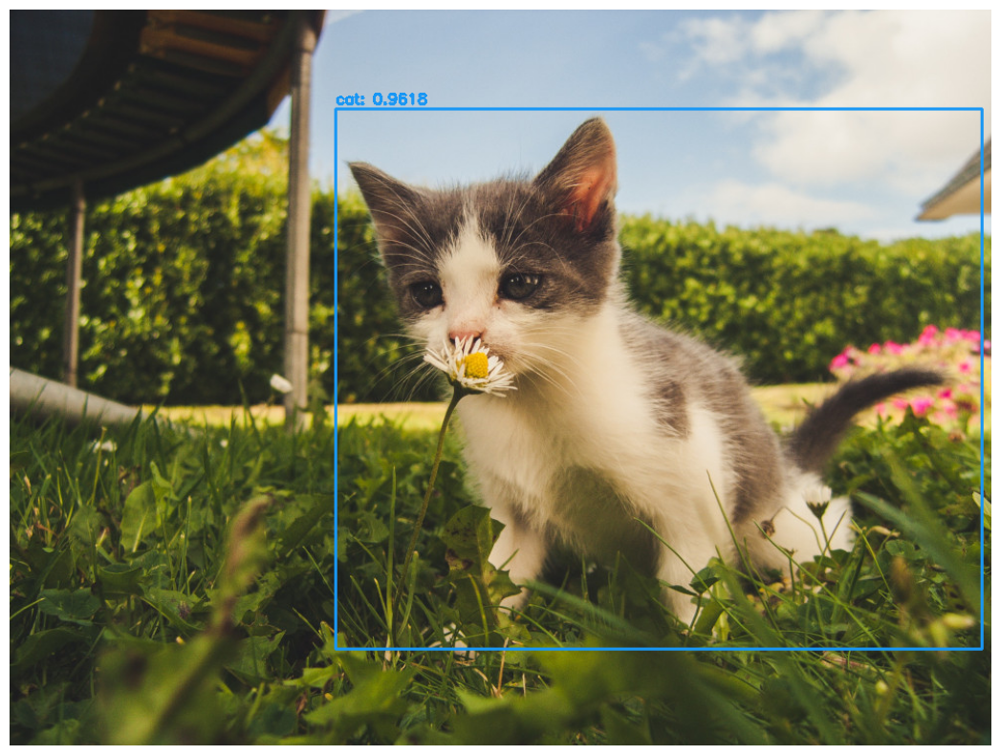

YOLO levou 1.38 segundos


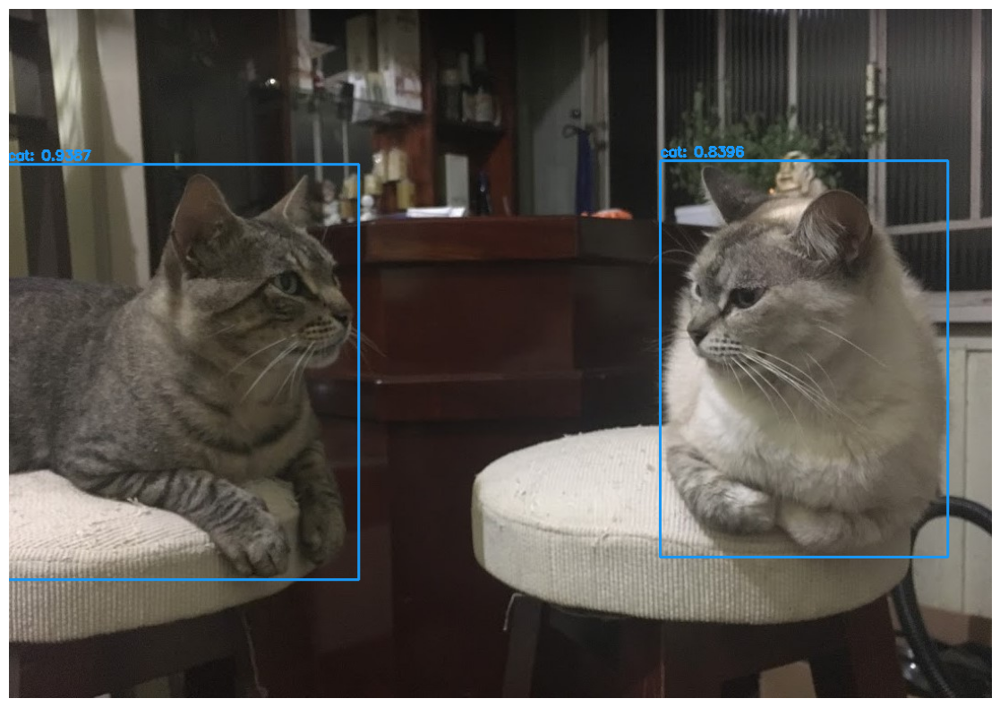

YOLO levou 1.89 segundos


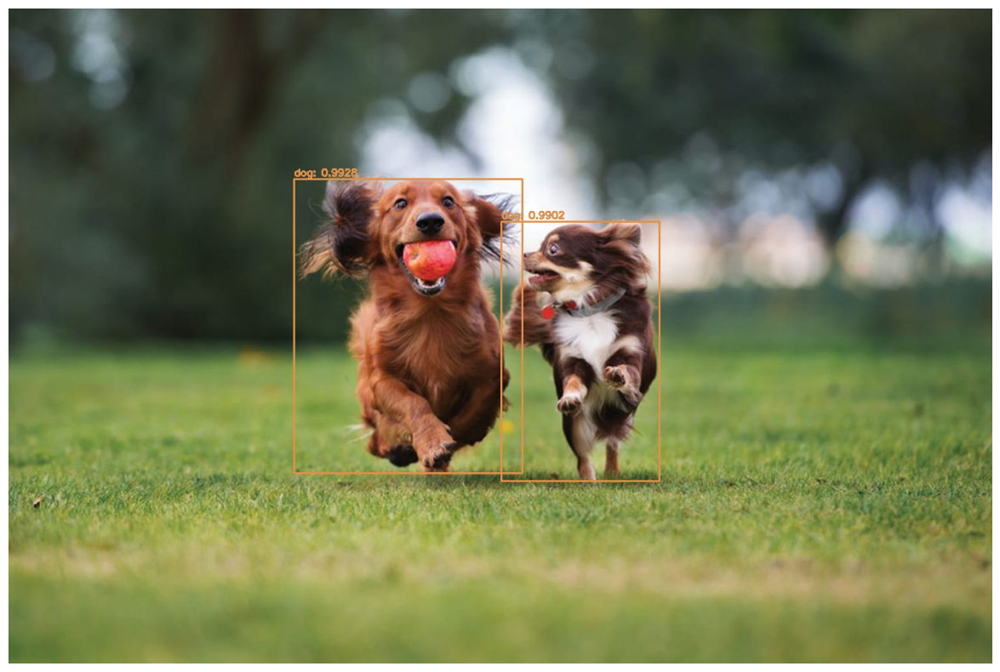

In [ ]:
for caminho_imagem in caminhos:
  try:
    imagem = cv2.imread(caminho_imagem)
    (H, W) = imagem.shape[:2]
  except:
    print('Erro ao carregar a imagem -> ' + caminho_imagem)
    continue

  imagem_cp = imagem.copy()
  net, imagem, layer_outputs = blob_imagem(net, imagem)

  caixas = []
  confiancas = []
  IDclasses = []

  # Pegar os valores das variáveis, caixas, confiancas e IDclasses
  for output in layer_outputs:
    for detection in output:
      caixas, confiancas, IDclasses = deteccoes(detection, _threshold, caixas, confiancas, IDclasses)
  # Realizar supressão não máxima
  objs = cv2.dnn.NMSBoxes(caixas, confiancas, _threshold, _threshold_NMS)

  if len(objs) > 0:
    for i in objs.flatten():
      imagem, x, y, w, h = funcoes_imagem(imagem, i, confiancas, caixas, COLORS, LABELS, mostrar_texto=False)
      objeto = imagem_cp[y:y + h, x:x + w]

  mostrar(imagem)

# Contando quantas vezes algum objeto específico apareceu em múltiplas imagens

In [ ]:
diretorio_fotos = "fotos_teste/"
caminhos = [os.path.join(diretorio_fotos, f) for f in os.listdir(diretorio_fotos)]
print(caminhos)
threshold = 0.5
threshold_NMS = 0.3

['fotos_teste/img-canecas.jpg', 'fotos_teste/gato03.jpg', 'fotos_teste/person.jpg', 'fotos_teste/dog.jpg', 'fotos_teste/cachorros.jpg', 'fotos_teste/gato02.jpg', 'fotos_teste/gato04.jpg', 'fotos_teste/cachorros02.jpg']


YOLO levou 1.37 segundos
Pessoas detectadas na imagem fotos_teste/img-canecas.jpg: 0


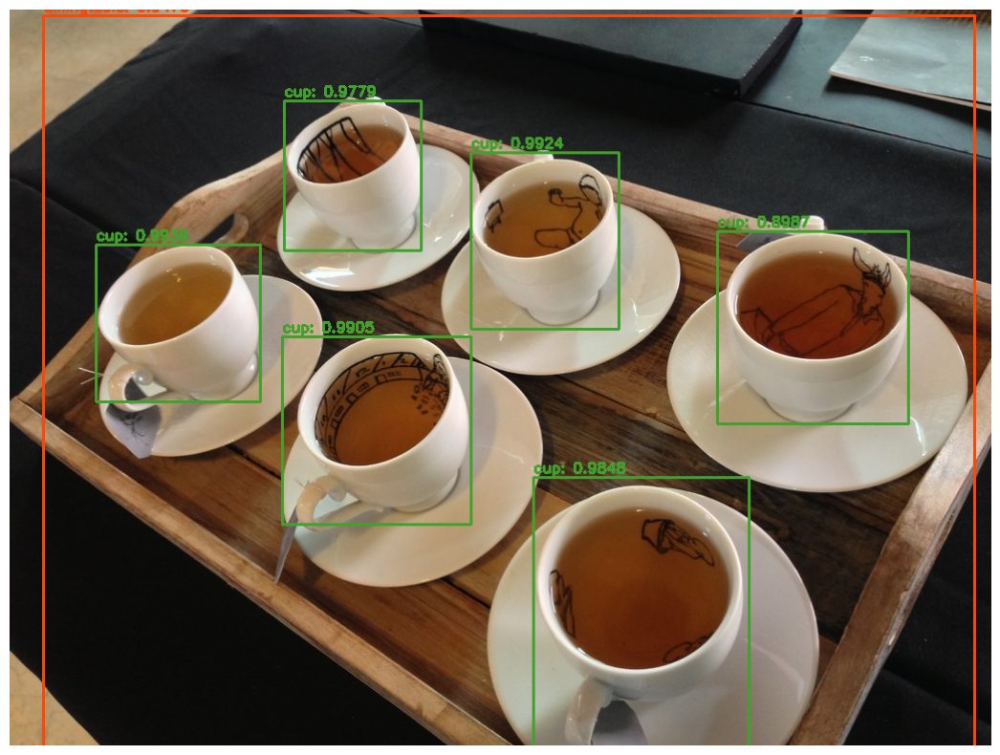

YOLO levou 1.98 segundos
Pessoas detectadas na imagem fotos_teste/gato03.jpg: 0


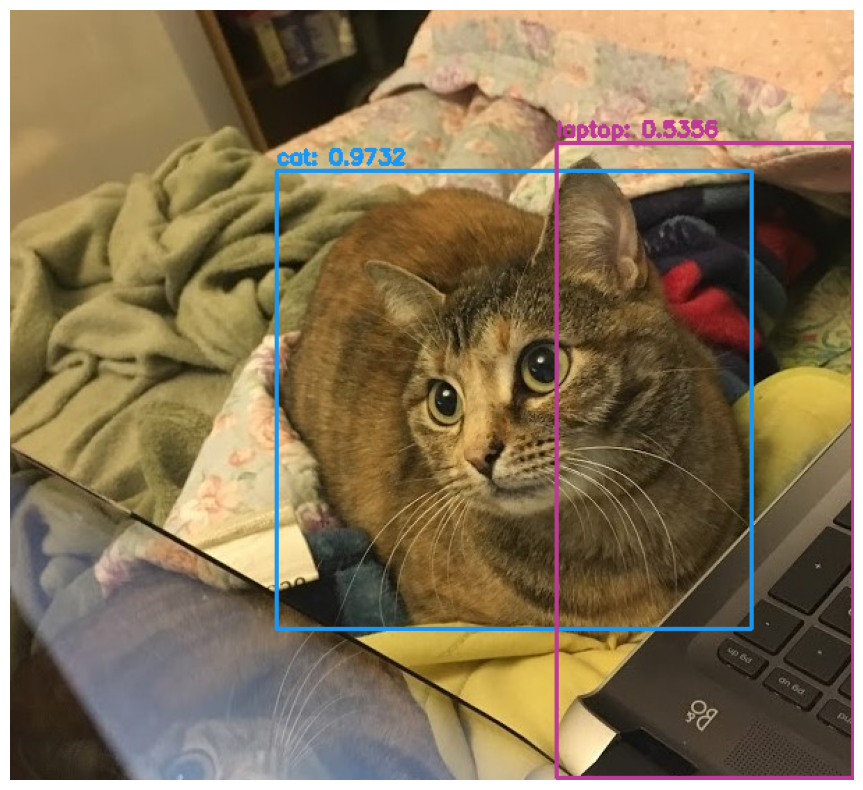

YOLO levou 1.75 segundos
Pessoas detectadas na imagem fotos_teste/person.jpg: 1


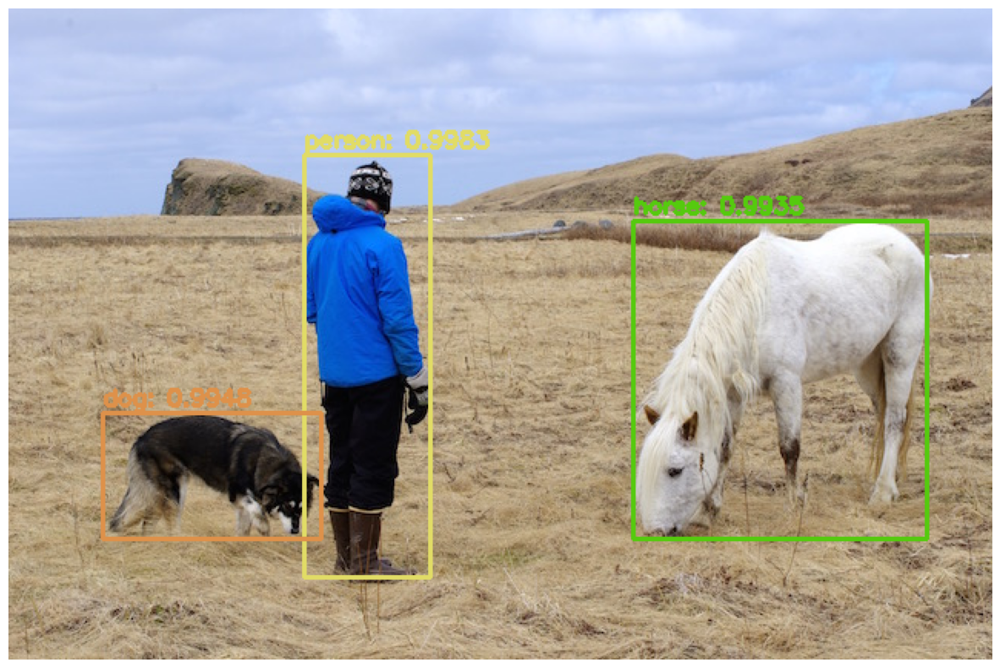

YOLO levou 1.25 segundos
Pessoas detectadas na imagem fotos_teste/dog.jpg: 0


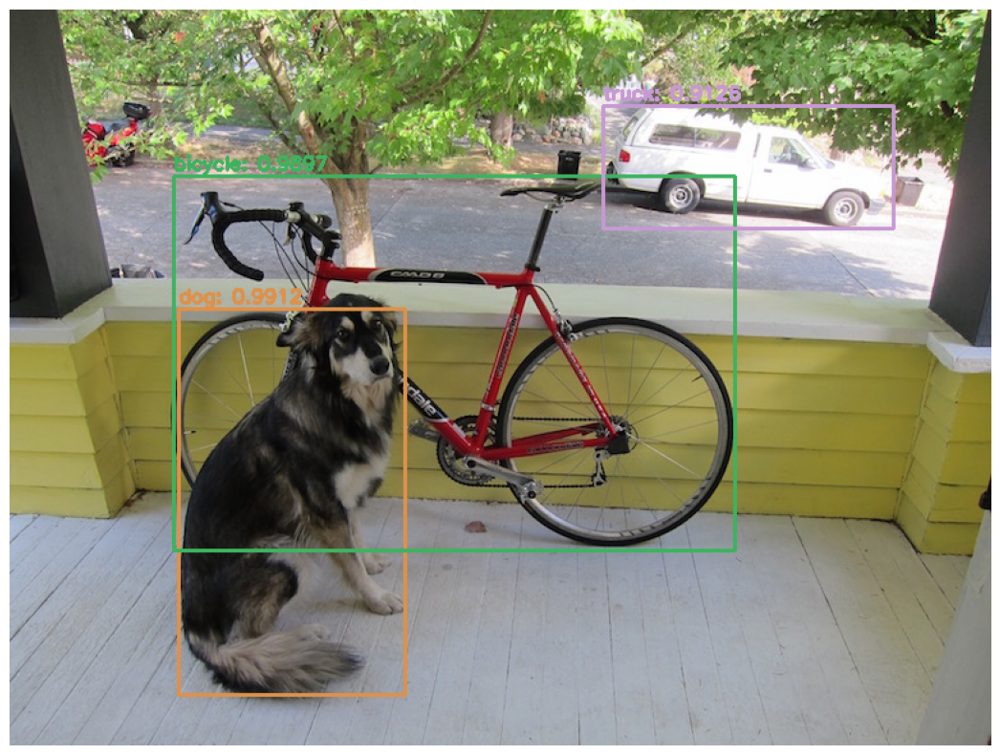

YOLO levou 1.28 segundos
Pessoas detectadas na imagem fotos_teste/cachorros.jpg: 0


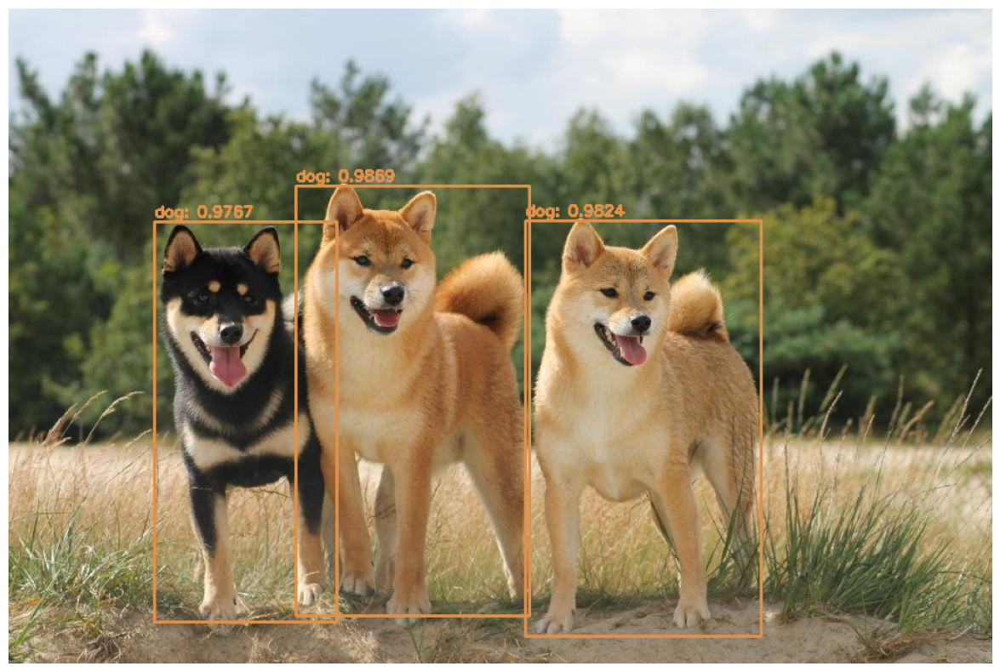

YOLO levou 1.31 segundos
Pessoas detectadas na imagem fotos_teste/gato02.jpg: 0


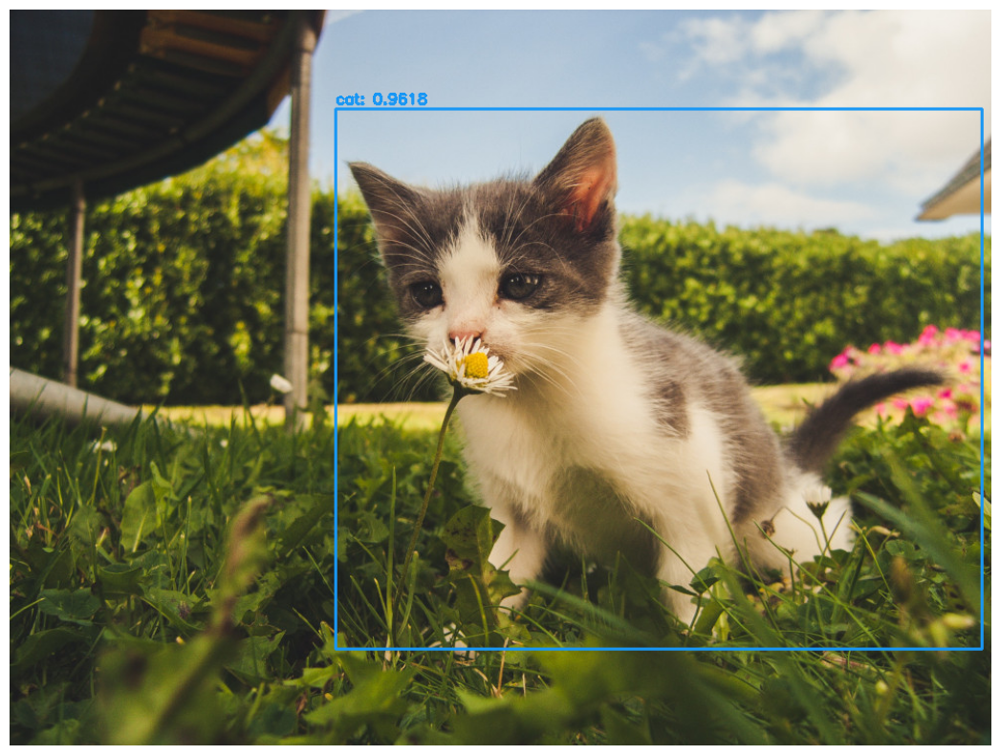

YOLO levou 1.33 segundos
Pessoas detectadas na imagem fotos_teste/gato04.jpg: 0


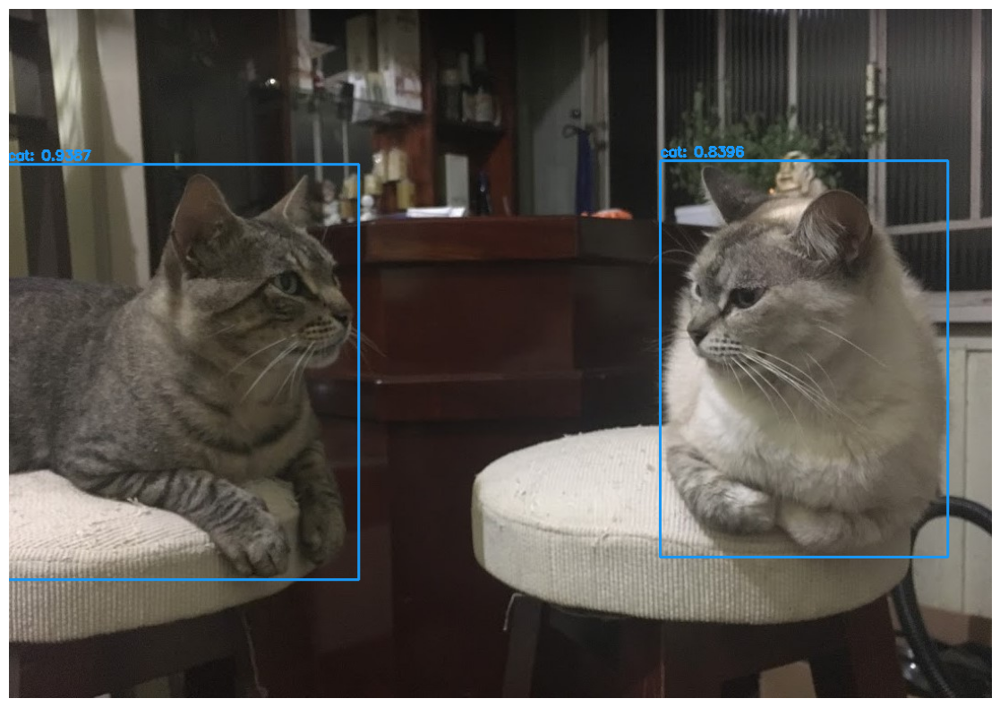

YOLO levou 1.35 segundos
Pessoas detectadas na imagem fotos_teste/cachorros02.jpg: 0


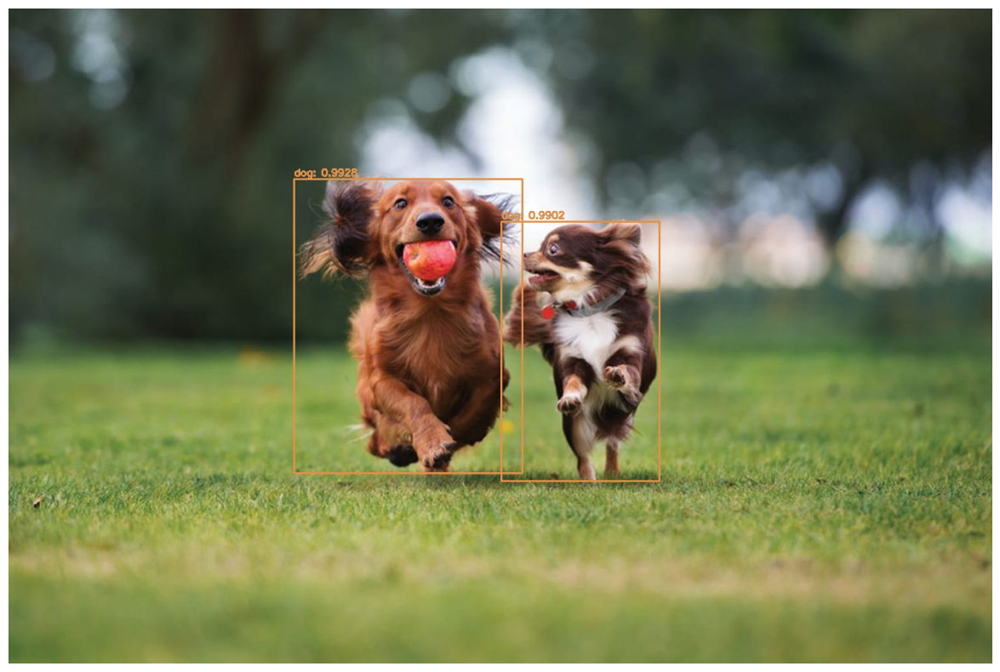

In [ ]:
contagem = 0
contagem_total = 0

for caminho_imagem in caminhos:
  try:
    imagem = cv2.imread(caminho_imagem)
    (H, W) = imagem.shape[:2]
  except:
    print('Erro ao carregar a imagem -> ' + caminho_imagem)
    continue

  contagem = 0

  imagem_cp = imagem.copy()
  # Obtemos as previsões
  net, imagem, layer_outputs = blob_imagem(net, imagem)

  caixas = []
  confiancas = []
  IDclasses = []
  # Percorremos as previsões para pegar as caixas, confiancas e IDclasses
  for output in layer_outputs:
    for detection in output:
      caixas, confiancas, IDclasses = deteccoes(detection, threshold, caixas, confiancas, IDclasses)
  # Supressão não máxima
  objs = cv2.dnn.NMSBoxes(caixas, confiancas, threshold, threshold_NMS)

  if len(objs) > 0:
    for i in objs.flatten():
      # Contar a quantidade de pessoas
      if LABELS[IDclasses[i]] == 'person':
        contagem += 1
        contagem_total += 1

      imagem, x, y, w, h = funcoes_imagem(imagem, i, confiancas, caixas, COLORS, LABELS, mostrar_texto=False)
      objeto = imagem_cp[y:y + h, x:x + w]

  print('Pessoas detectadas na imagem ' + str(caminho_imagem) + ': ' + str(contagem))
  mostrar(imagem)

In [ ]:
print('Total de pessoas detectadas: ' + str(contagem_total))

Total de pessoas detectadas: 1


# Fazendo a detecção apenas de objetos específicos do modelo

In [ ]:
diretorio_fotos = "fotos_teste/"
caminhos = [os.path.join(diretorio_fotos, f) for f in os.listdir(diretorio_fotos)]
print(caminhos)
threshold = 0.5
threshold_NMS = 0.3

['fotos_teste/img-canecas.jpg', 'fotos_teste/gato03.jpg', 'fotos_teste/person.jpg', 'fotos_teste/dog.jpg', 'fotos_teste/cachorros.jpg', 'fotos_teste/gato02.jpg', 'fotos_teste/gato04.jpg', 'fotos_teste/cachorros02.jpg']


YOLO levou 1.27 segundos


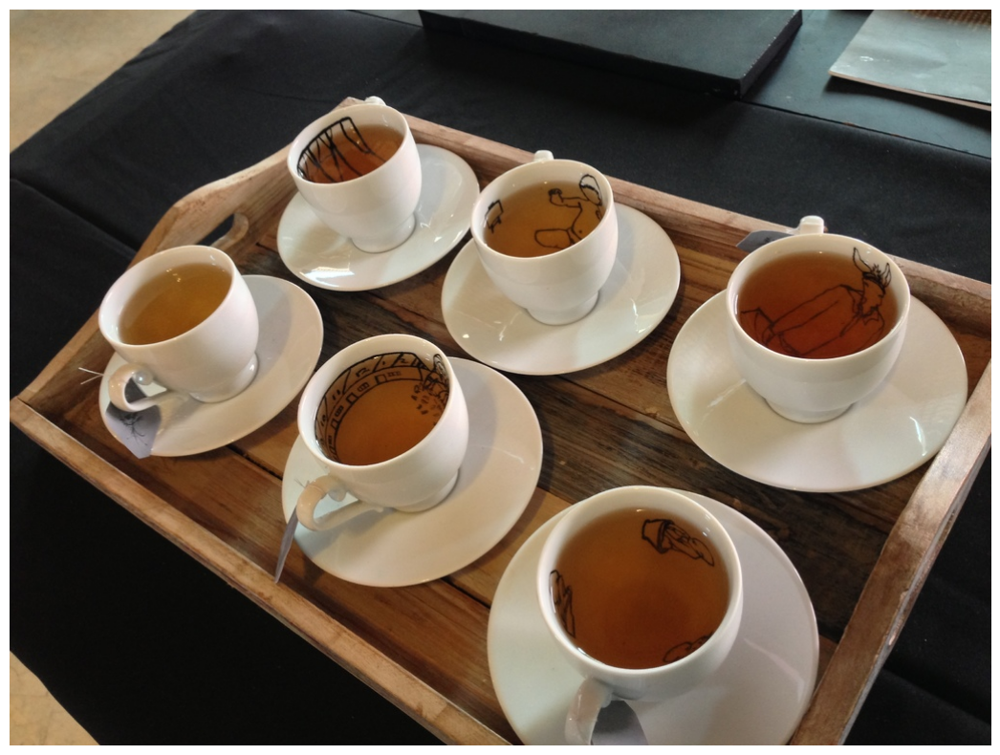

YOLO levou 1.24 segundos


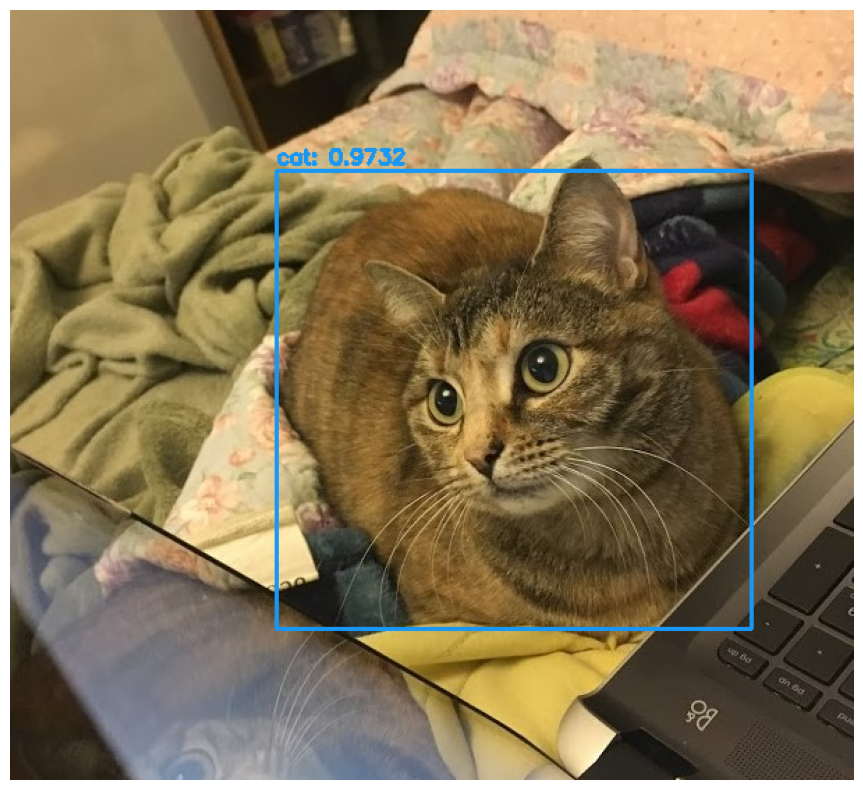

YOLO levou 1.78 segundos


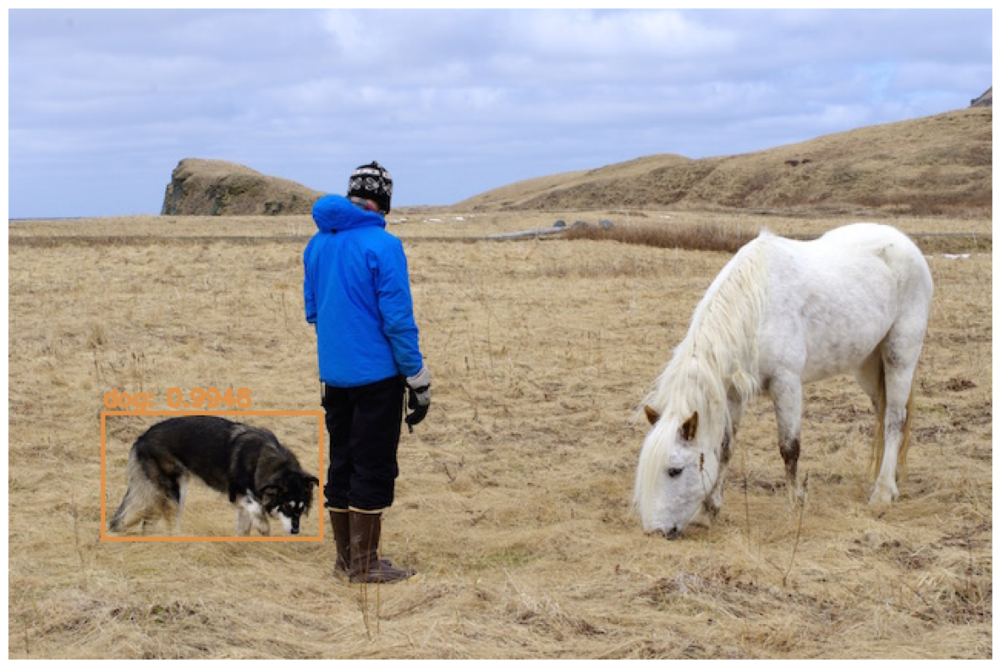

YOLO levou 2.47 segundos


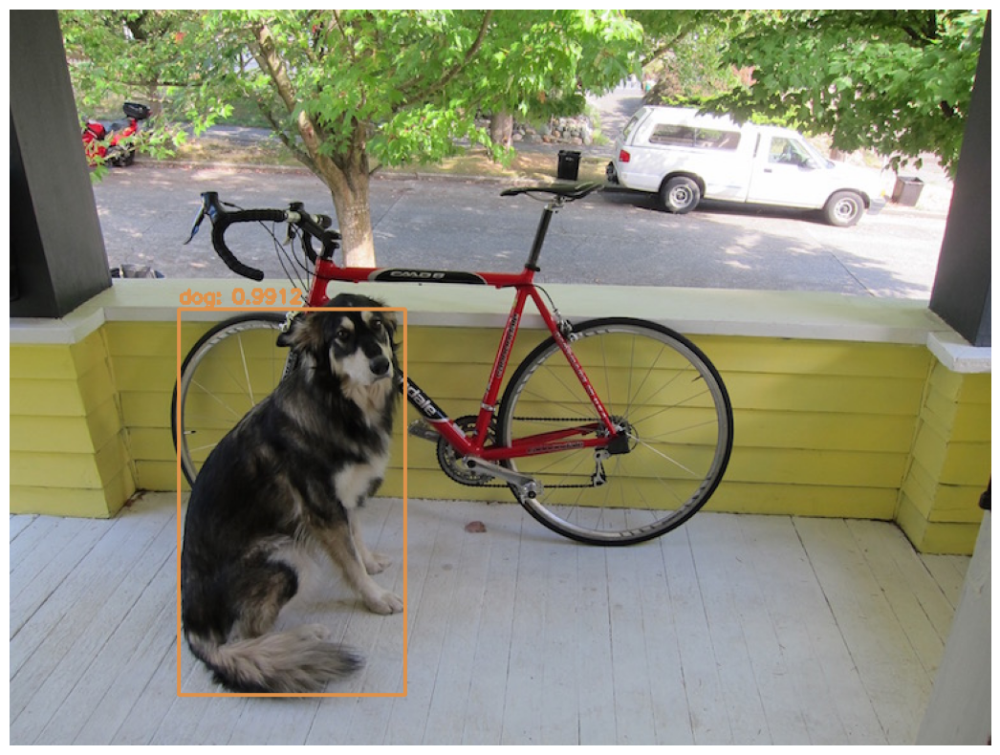

YOLO levou 1.76 segundos


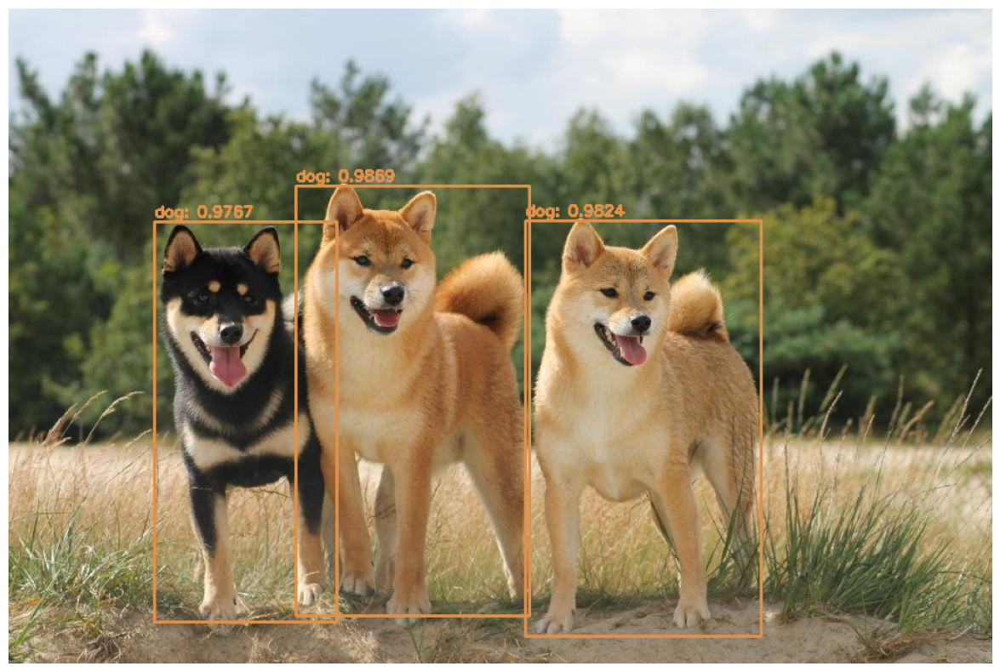

YOLO levou 1.96 segundos


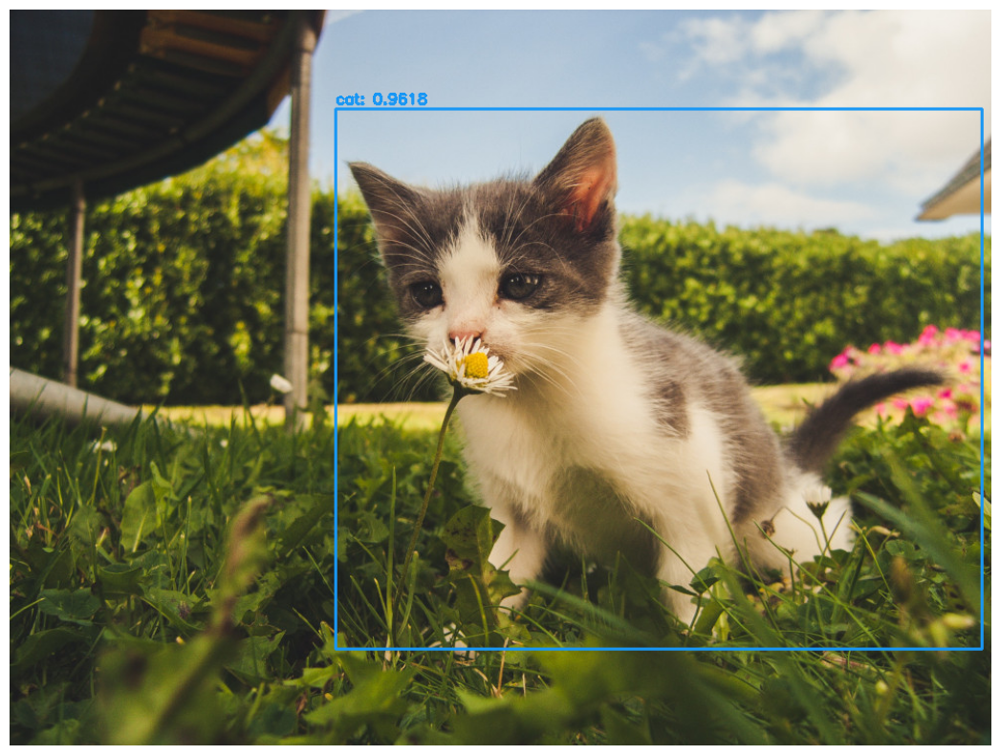

YOLO levou 1.31 segundos


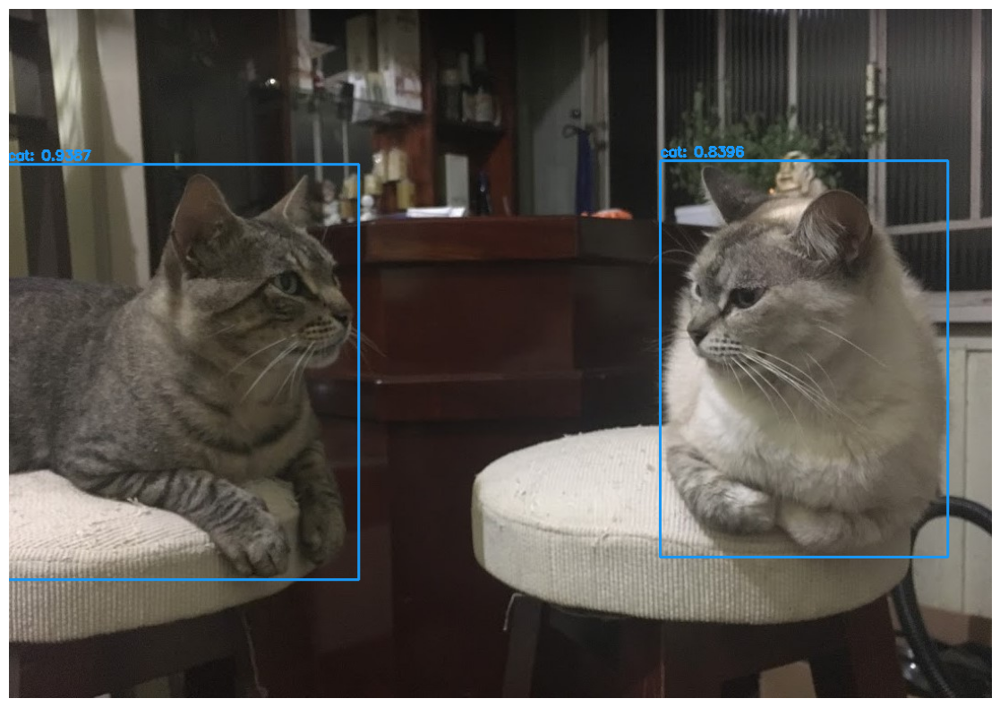

YOLO levou 1.30 segundos


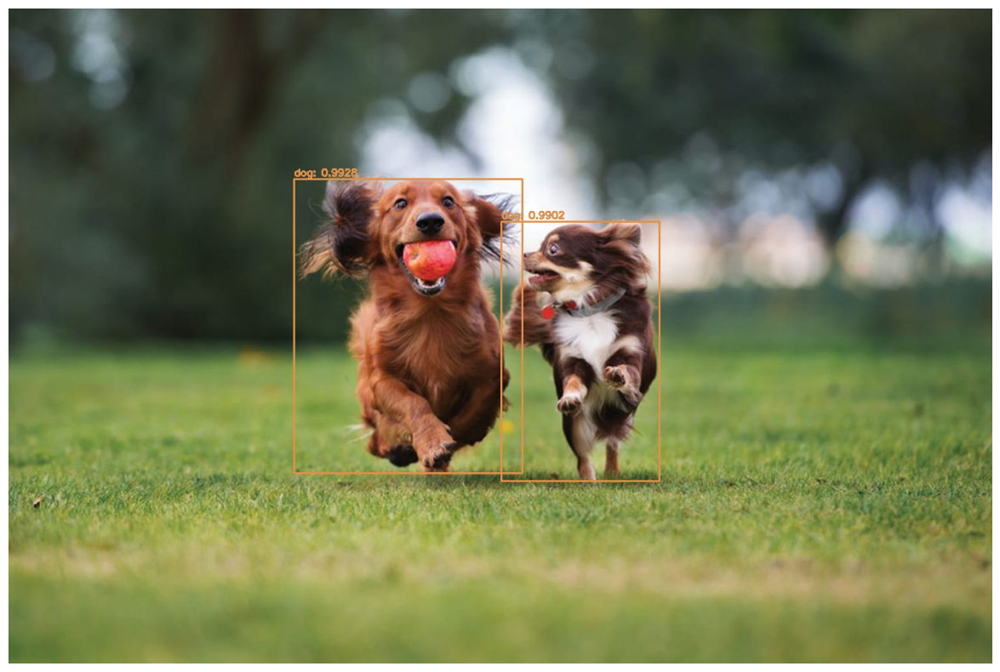

In [ ]:
# Detectar somente cachorros e gatos
classes = ['dog', 'cat']
for caminho_imagem in caminhos:
  try:
    imagem = cv2.imread(caminho_imagem)
    (H, W) = imagem.shape[:2]
  except:
    print('Erro ao carregar a imagem -> ' + caminho_imagem)
    continue

  imagem_cp = imagem.copy()
  net, imagem, layer_outputs = blob_imagem(net, imagem)

  caixas = []
  confiancas = []
  IDclasses = []

  for output in layer_outputs:
    for detection in output:
      caixas, confiancas, IDclasses = deteccoes(detection, _threshold, caixas, confiancas, IDclasses)

  objs = cv2.dnn.NMSBoxes(caixas, confiancas, _threshold, _threshold_NMS)

  if len(objs) > 0:
    for i in objs.flatten():
      # Desenhar os retangulos apenas se os labels estiverem dentro da nossa lista 'classes'
      if LABELS[IDclasses[i]] in classes:
        imagem, x, y, w, h = funcoes_imagem(imagem, i, confiancas, caixas, COLORS, LABELS, mostrar_texto=False)
        objeto = imagem_cp[y:y + h, x:x + w]

  mostrar(imagem)

# Modo mais legível

In [ ]:
def funcoes_imagem_v2(imagem, i, confiancas, caixas, COLORS, LABELS, mostrar_texto=True):
  (x, y) = (caixas[i][0], caixas[i][1]) # coordenada (x,y) onde inicia a caixa da detecção
  (w, h) = (caixas[i][2], caixas[i][3]) # largura e altura em pixels da caixa de detecção

  cor = [int(c) for c in COLORS[IDclasses[i]]]

  fundo = np.full((imagem.shape), (0,0,0), dtype=np.uint8)

  texto = "{}: {:.4f}".format(LABELS[IDclasses[i]], confiancas[i])

  cv2.putText(fundo, texto, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255,255,255), 2)

  fx,fy,fw,fh = cv2.boundingRect(fundo[:,:,2])

  cv2.rectangle(imagem, (x, y), (x + w, y + h), cor, 2)

  cv2.rectangle(imagem, (fx, fy), (fx + fw, fy + fh), cor, -1)
  cv2.rectangle(imagem, (fx, fy), (fx + fw, fy + fh), cor, 3)
  cv2.putText(imagem, texto, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,0,0), 1)

  if mostrar_texto:
    print("> " + texto)
    print(x,y,w,h)

  return imagem,x,y,w,h

In [ ]:
diretorio_fotos = "fotos_teste/"
caminhos = [os.path.join(diretorio_fotos, f) for f in os.listdir(diretorio_fotos)]
print(caminhos)
threshold = 0.5
threshold_NMS = 0.3

['fotos_teste/img-canecas.jpg', 'fotos_teste/gato03.jpg', 'fotos_teste/person.jpg', 'fotos_teste/dog.jpg', 'fotos_teste/cachorros.jpg', 'fotos_teste/gato02.jpg', 'fotos_teste/gato04.jpg', 'fotos_teste/cachorros02.jpg']


YOLO levou 2.02 segundos


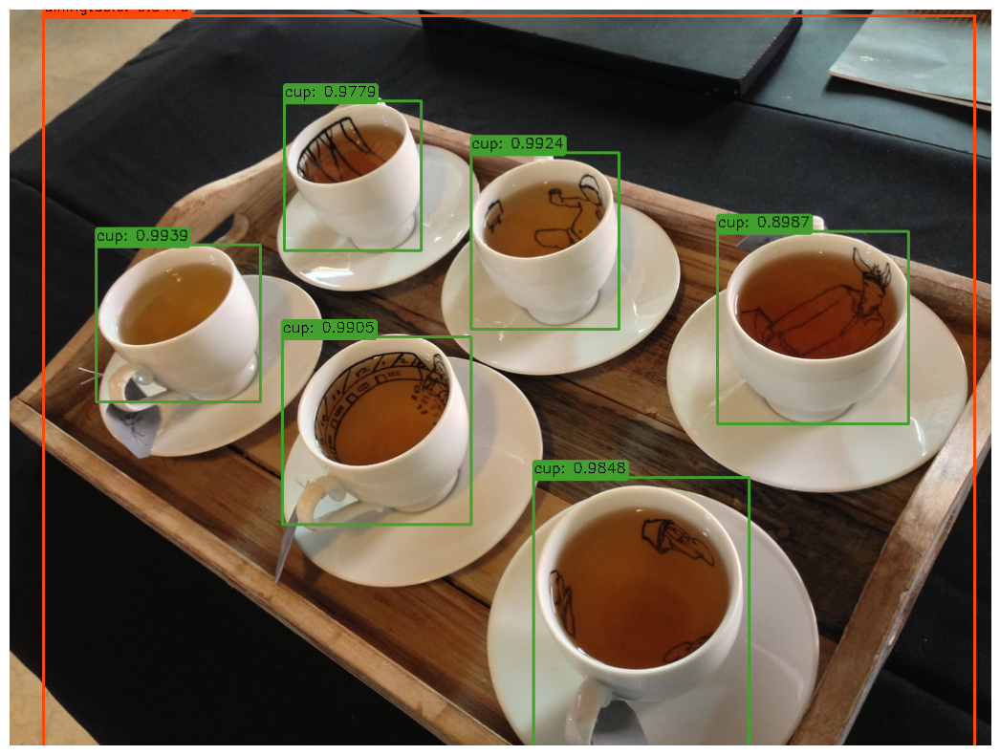

YOLO levou 1.24 segundos


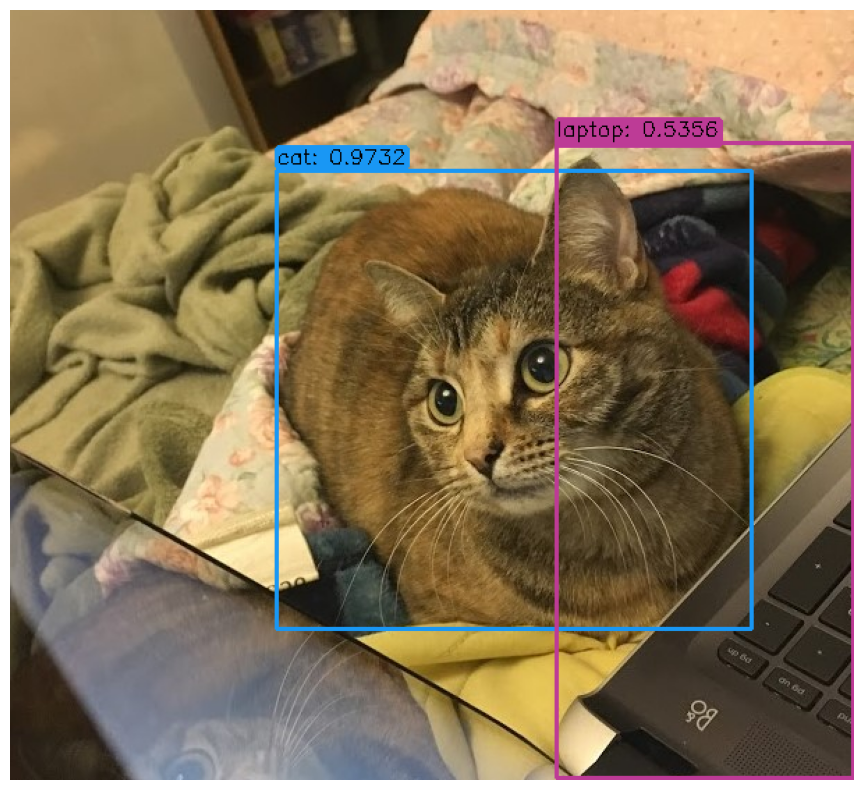

YOLO levou 1.23 segundos


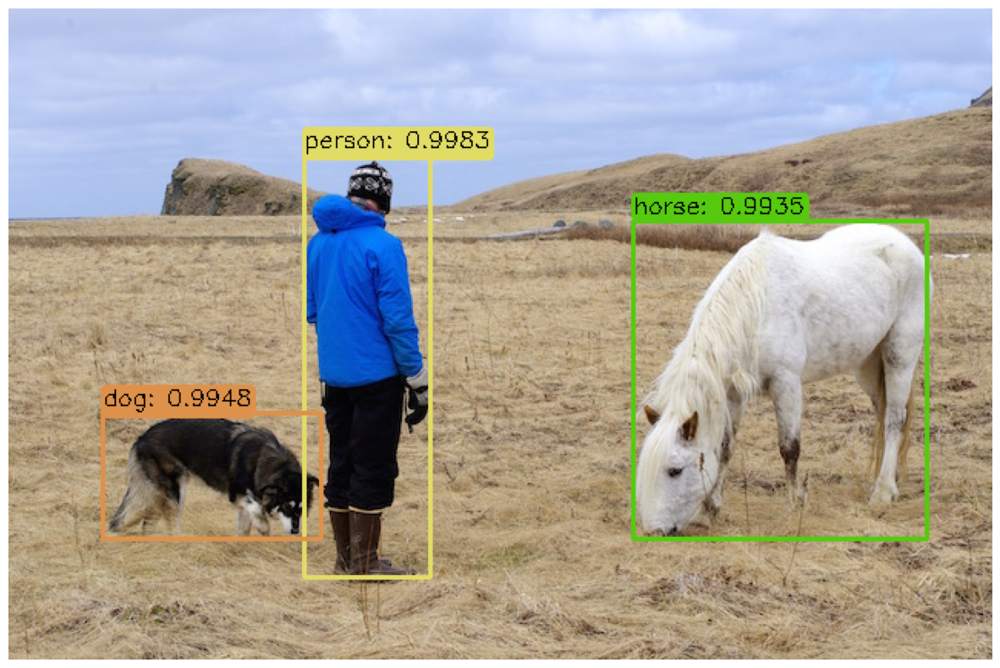

YOLO levou 1.94 segundos


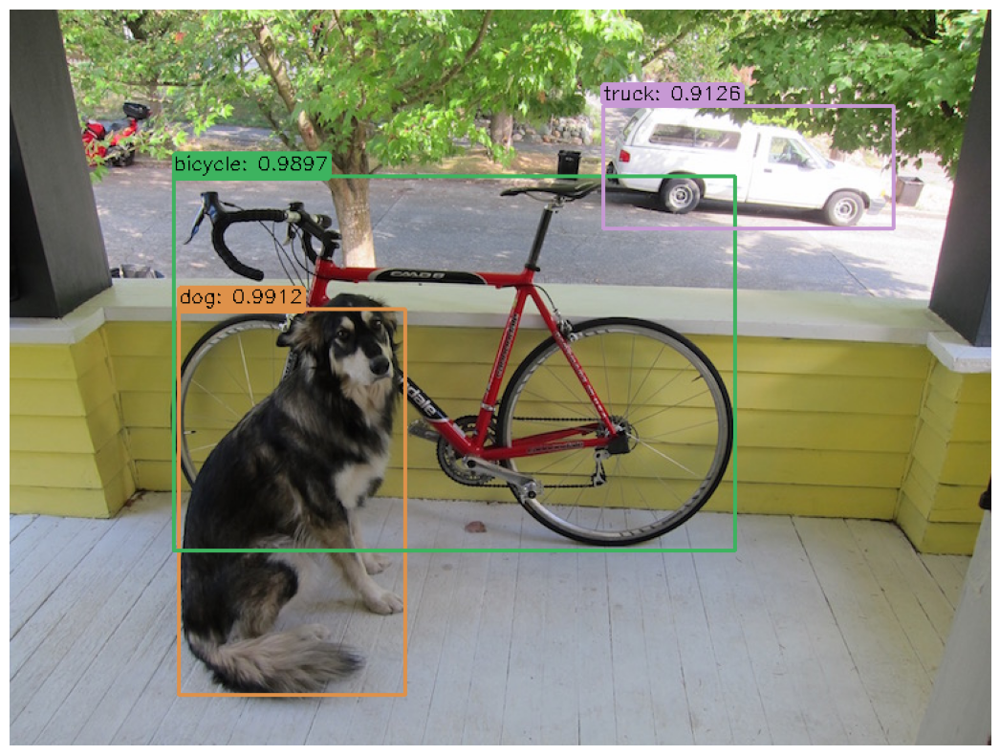

YOLO levou 1.53 segundos


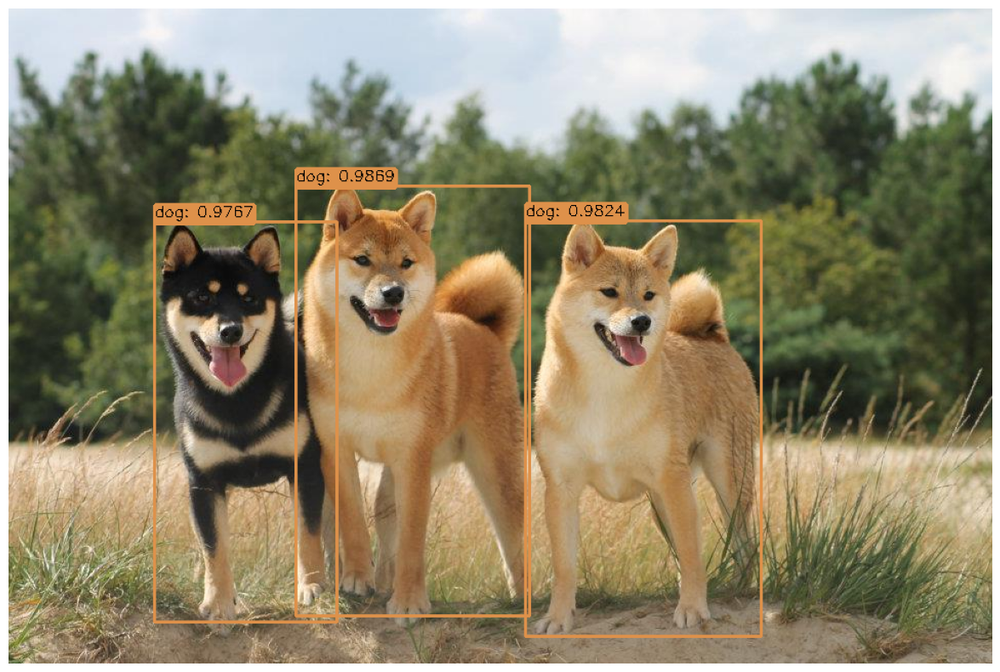

YOLO levou 1.27 segundos


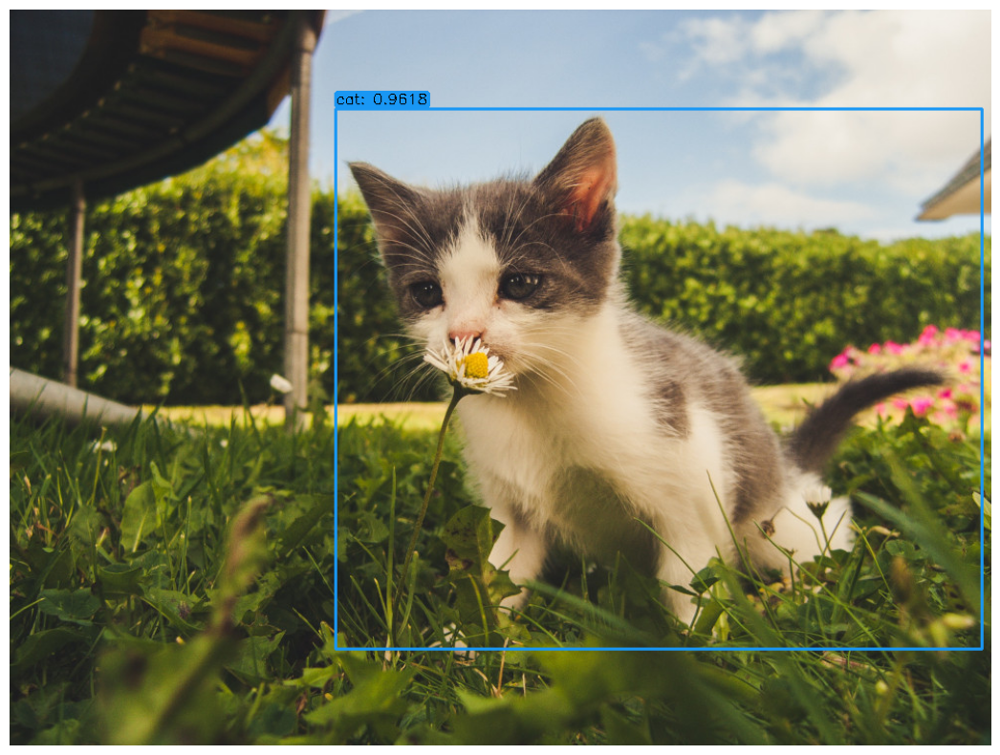

YOLO levou 1.27 segundos


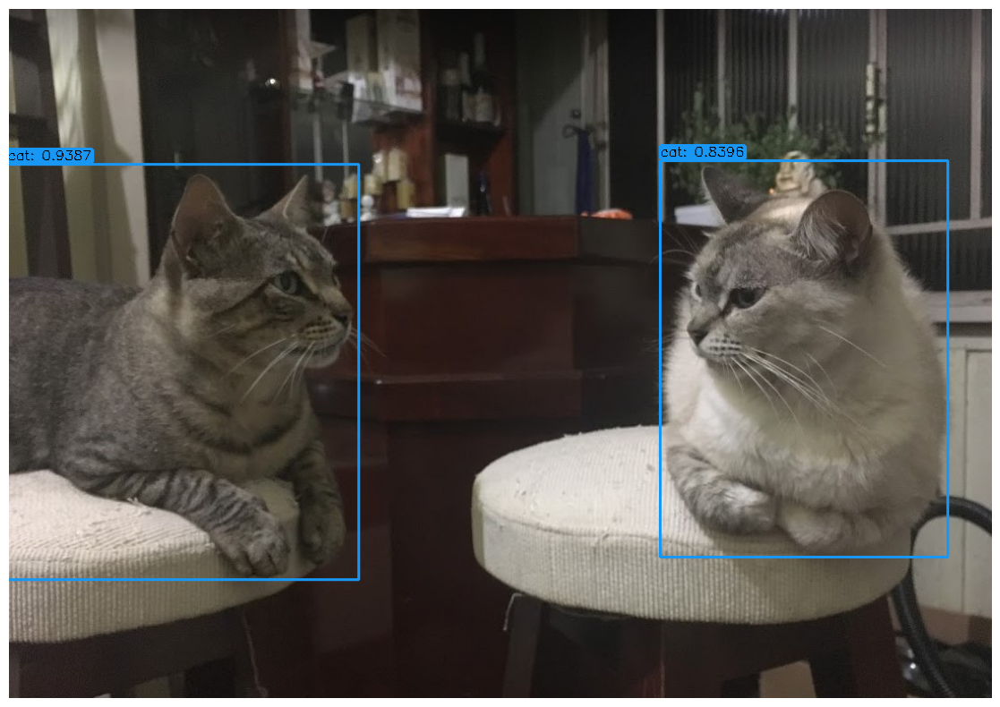

YOLO levou 1.29 segundos


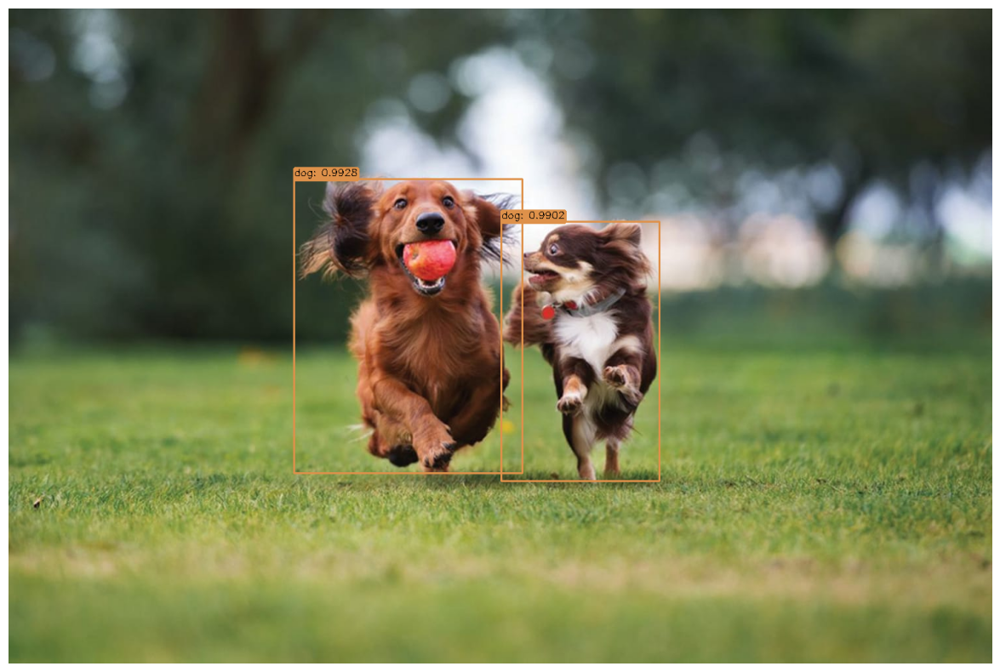

In [ ]:
for caminho_imagem in caminhos:
  try:
    imagem = cv2.imread(caminho_imagem)
    (H, W) = imagem.shape[:2]
  except:
    print('Erro ao carregar a imagem -> ' + caminho_imagem)
    continue

  imagem_cp = imagem.copy()
  net, imagem, layer_outputs = blob_imagem(net, imagem)

  caixas = []
  confiancas = []
  IDclasses = []

  for output in layer_outputs:
    for detection in output:
      caixas, confiancas, IDclasses = deteccoes(detection, _threshold, caixas, confiancas, IDclasses)

  objs = cv2.dnn.NMSBoxes(caixas, confiancas, _threshold, _threshold_NMS)

  if len(objs) > 0:
    for i in objs.flatten():
      imagem, x, y, w, h = funcoes_imagem_v2(imagem, i, confiancas, caixas, COLORS, LABELS, mostrar_texto=False)
      objeto = imagem_cp[y:y + h, x:x + w]

  mostrar(imagem)